# 第8章 ニューラルネットワーク・ディープラーニングの応用～手書き数字の認識～（2）
## 8.4 空間フィルター

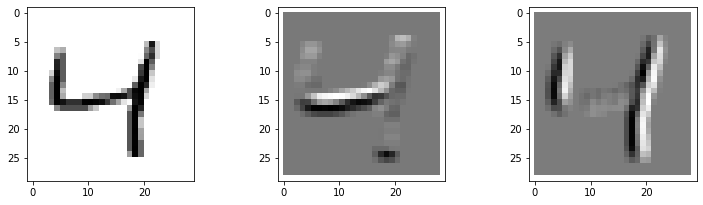

In [2]:
# リスト 8-2-(1)
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.datasets import mnist
from tensorflow.keras.utils import to_categorical
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = x_train.reshape(60000, 28, 28, 1)
x_test = x_test.reshape(10000, 28, 28, 1)
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
num_classes = 10
y_train = to_categorical(y_train, num_classes)
y_test = to_categorical(y_test, num_classes)

# リスト 8-2-(2)
import matplotlib.pyplot as plt
%matplotlib inline

id_img = 2
myfil1 = np.array([[1, 1, 1], [1, 1, 1], [-2, -2, -2]], dtype=float)
myfil2 = np.array([[-2, 1, 1], [-2, 1, 1], [-2, 1, 1]], dtype=float)
x_img = x_train[id_img, :, :, 0]
img_h = 28
img_w = 28
x_img = x_img.reshape(img_h, img_w)
out_img1 = np.zeros_like(x_img)
out_img2 = np.zeros_like(x_img)

# フィルター処理
for ih in range(img_h - 3):
    for iw in range(img_w - 3):
        img_part = x_img[ih:ih + 3, iw:iw + 3]
        out_img1[ih + 1, iw + 1] = np.dot(img_part.reshape(-1), myfil1.reshape(-1))
        out_img2[ih + 1, iw + 1] = np.dot(img_part.reshape(-1), myfil2.reshape(-1))

# 表示
plt.figure(1, figsize=(12, 3.2))
plt.subplots_adjust(wspace=0.5)
plt.gray()
plt.subplot(1, 3, 1)
plt.pcolor(1 - x_img)
plt.xlim(-1, 29)
plt.ylim(29, -1)

plt.subplot(1, 3, 2)
plt.pcolor(-out_img1)
plt.xlim(-1, 29)
plt.ylim(29, -1)

plt.subplot(1, 3, 3)
plt.pcolor(-out_img2)
plt.xlim(-1, 29)
plt.ylim(29, -1)

plt.show()

## 8.5 畳み込みニューラルネットワーク

In [3]:
# リスト 8-2-(3)
np.random.seed(1)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Activation, Dropout, Flatten, Dense
from tensorflow.keras.optimizers import Adam
import time

model = Sequential()
model.add(Conv2D(8, (3, 3), padding='same', input_shape=(28, 28, 1), activation='relu'))
model.add(Flatten())
model.add(Dense(10, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])
startTime = time.time()
history = model.fit(x_train, y_train, epochs=20, batch_size=1000, verbose=1, validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss : ', score[0])
print('Test accuracy : ', score[1])
print('Computation time : {0:.3f} sec'.format(time.time() - startTime))

Train on 60000 samples, validate on 10000 samples
Epoch 1/20
60000/60000 [==============================] - 5s 77us/sample - loss: 0.9442 - accuracy: 0.7918 - val_loss: 0.3704 - val_accuracy: 0.8984
Epoch 2/20
60000/60000 [==============================] - 5s 79us/sample - loss: 0.3297 - accuracy: 0.9064 - val_loss: 0.2764 - val_accuracy: 0.9215
Epoch 3/20
60000/60000 [==============================] - 4s 70us/sample - loss: 0.2658 - accuracy: 0.9248 - val_loss: 0.2360 - val_accuracy: 0.9340
Epoch 4/20
60000/60000 [==============================] - 4s 70us/sample - loss: 0.2241 - accuracy: 0.9374 - val_loss: 0.2004 - val_accuracy: 0.9444
Epoch 5/20
60000/60000 [==============================] - 4s 64us/sample - loss: 0.1913 - accuracy: 0.9464 - val_loss: 0.1729 - val_accuracy: 0.9532
Epoch 6/20
60000/60000 [==============================] - 4s 65us/sample - loss: 0.1648 - accuracy: 0.9540 - val_loss: 0.1525 - val_accuracy: 0.9587
Epoch 7/20
60000/60000 [==============================] 

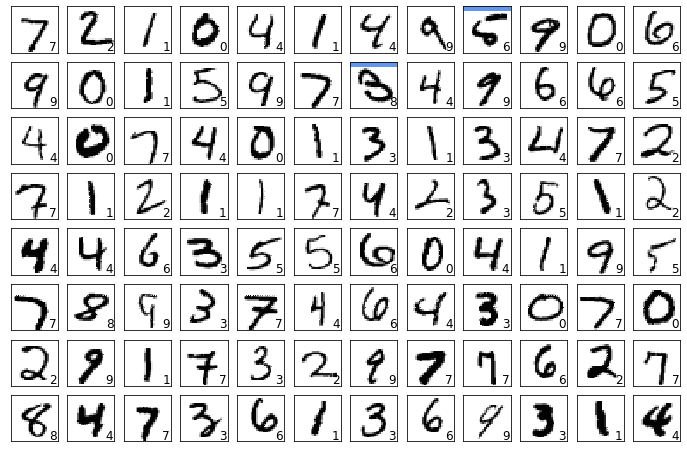

In [4]:
# リスト 8-2-(4)
def show_prediction():
    n_show = 96
    y = model.predict(x_test)
    plt.figure(2, figsize=(12, 8))
    plt.gray()
    for i in range(n_show):
        plt.subplot(8, 12, i + 1)
        x = x_test[i, :]
        x = x.reshape(28, 28)
        plt.pcolor(1 - x)
        wk = y[i, :]
        prediction = np.argmax(wk)
        plt.text(22, 25.5, '%d' % prediction, fontsize=12)
        if prediction != np.argmax(y_test[i, :]):
            plt.plot([0, 27], [1, 1], color='cornflowerblue', linewidth=5)
        plt.xlim(0, 27)
        plt.ylim(27, 0)
        plt.xticks([], '')
        plt.yticks([], '')

show_prediction()
plt.show()

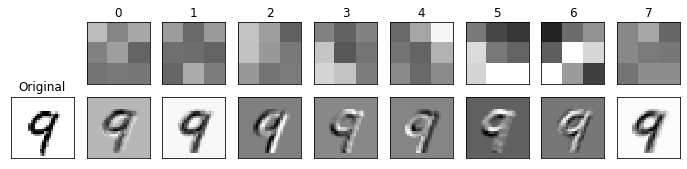

In [9]:
# リスト 8-2-(5)
plt.figure(1, figsize=(12, 2.5))
plt.gray()
plt.subplots_adjust(wspace=0.2, hspace=0.2)
plt.subplot(2, 9, 10)
id_img = 12
x_img = x_test[id_img, :, :, 0]
img_h = 28
img_w = 28
x_img = x_img.reshape(img_h, img_w)
plt.pcolor(-x_img)
plt.xlim(0, img_h)
plt.ylim(img_w, 0)
plt.xticks([], '')
plt.yticks([], '')
plt.title('Original')

w = model.layers[0].get_weights()[0]
max_w = np.max(w)
min_w = np.min(w)
for i in range(8):
    plt.subplot(2, 9, i + 2)
    w1 = w[:, :, 0, i]
    w1 = w1.reshape(3, 3)
    plt.pcolor(-w1, vmin=min_w, vmax=max_w)
    plt.xlim(0, 3)
    plt.ylim(3, 0)
    plt.xticks([], '')
    plt.yticks([], '')
    plt.title('%d' % i)
    plt.subplot(2, 9, i + 11)
    out_img = np.zeros_like(x_img)
    # フィルター処理
    for ih in range(img_h - 3):
        for iw in range(img_w - 3):
            img_part = x_img[ih:ih + 3, iw:iw + 3]
            out_img[ih + 1, iw + 1] = np.dot(img_part.reshape(-1), w1.reshape(-1))
    plt.pcolor(-out_img)
    plt.xlim(0, img_w)
    plt.ylim(img_h, 0)
    plt.xticks([], '')
    plt.yticks([], '')
plt.show()

## 8.6 プーリング
サンプルコードなし

## 8.7 ドロップアウト
サンプルコードなし

## 8.8 集大成のMNIST認識ネットワークモデル

In [10]:
# リスト 8-2-(6)
model = Sequential()
model.add(Conv2D(16, (3, 3), input_shape=(28, 28, 1), activation='relu'))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.25))
model.add(Dense(num_classes, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])
startTime = time.time()
history = model.fit(x_train, y_train, epochs=20, batch_size=1000, verbose=1, validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss : ', score[0])
print('Test accuracy : ', score[1])
print('Computation time : {0:.3f} sec'.format(time.time() - startTime))

Train on 60000 samples, validate on 10000 samples
Epoch 1/20
60000/60000 [==============================] - 26s 435us/sample - loss: 0.7070 - accuracy: 0.7873 - val_loss: 0.1362 - val_accuracy: 0.9587
Epoch 2/20
60000/60000 [==============================] - 29s 478us/sample - loss: 0.1406 - accuracy: 0.9571 - val_loss: 0.0663 - val_accuracy: 0.9798
Epoch 3/20
60000/60000 [==============================] - 27s 450us/sample - loss: 0.0923 - accuracy: 0.9720 - val_loss: 0.0466 - val_accuracy: 0.9847
Epoch 4/20
60000/60000 [==============================] - 25s 420us/sample - loss: 0.0715 - accuracy: 0.9779 - val_loss: 0.0387 - val_accuracy: 0.9879
Epoch 5/20
60000/60000 [==============================] - 25s 413us/sample - loss: 0.0602 - accuracy: 0.9815 - val_loss: 0.0329 - val_accuracy: 0.9897
Epoch 6/20
60000/60000 [==============================] - 25s 414us/sample - loss: 0.0506 - accuracy: 0.9849 - val_loss: 0.0314 - val_accuracy: 0.9904
Epoch 7/20
60000/60000 [====================

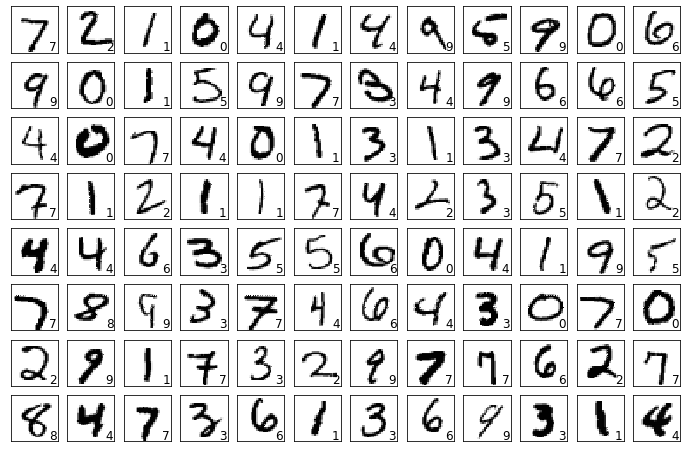

In [11]:
# リスト 8-2-(7)
show_prediction()
plt.show()